In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import date

In [2]:
df = pd.read_csv('globalterrorism.csv', encoding="ISO-8859-1")
df

,year,month,day,country_txt,region,region_txt,provstate,city,latitude,longitude,...,natlty1,natlty1_txt,gname,motive,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weapdetail,nkill
0,1970,7,2,Dominican Republic,2,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,...,58.0,Dominican Republic,MANO-D,NaN,13,Unknown,NaN,NaN,NaN,1.0
1,1970,0,0,Mexico,1,North America,Federal,Mexico city,19.371887,-99.086624,...,21.0,Belgium,23rd of September Communist League,NaN,13,Unknown,NaN,NaN,NaN,0.0
2,1970,1,0,Philippines,5,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,...,217.0,United States,Unknown,NaN,13,Unknown,NaN,NaN,NaN,1.0
3,1970,1,0,Greece,8,Western Europe,Attica,Athens,37.997490,23.762728,...,217.0,United States,Unknown,NaN,6,Explosives,16.0,Unknown Explosive Type,Explosive,NaN
4,1970,1,0,Japan,4,East Asia,Fukouka,Fukouka,33.580412,130.396361,...,217.0,United States,Unknown,NaN,8,Incendiary,NaN,NaN,Incendiary,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,11,Sub-Saharan Africa,Middle Shebelle,Ceelka Geelow,2.359673,45.385034,...,182.0,Somalia,Al-Shabaab,NaN,5,Firearms,5.0,Unknown Gun Type,NaN,1.0
181687,2017,12,31,Syria,10,Middle East & North Africa,Lattakia,Jableh,35.407278,35.942679,...,167.0,Russia,Muslim extremists,NaN,6,Explosives,11.0,"Projectile (rockets, mortars, RPGs, etc.)",Mortars were used in the attack.,2.0
181688,2017,12,31,Philippines,5,Southeast Asia,Maguindanao,Kubentog,6.900742,124.437908,...,160.0,Philippines,Bangsamoro Islamic Freedom Movement (BIFM),NaN,8,Incendiary,18.0,Arson/Fire,NaN,0.0
181689,2017,12,31,India,6,South Asia,Manipur,Imphal,24.798346,93.940430,...,92.0,India,Unknown,NaN,6,Explosives,7.0,Grenade,A thrown grenade was used in the attack.,0.0


In [3]:
df.describe()

,year,month,day,region,latitude,longitude,specificity,success,suicide,attacktype1,targtype1,targsubtype1,natlty1,weaptype1,weapsubtype1,nkill
count,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,181691.000000,181691.000000,181691.000000,181691.000000,171318.000000,180132.000000,181691.000000,160923.000000,171378.000000
mean,2002.638997,6.467277,15.505644,7.160938,23.498343,-4.586957e+02,1.451452,0.889598,0.036507,3.247547,8.439719,46.971474,127.686441,6.447325,11.117162,2.403272
std,13.259430,3.388303,8.814045,2.933408,18.569242,2.047790e+05,0.995430,0.313391,0.187549,1.915772,6.653838,30.953357,89.299120,2.173435,6.495612,11.545741
min,1970.000000,0.000000,0.000000,1.000000,-53.154613,-8.618590e+07,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,0.000000
25%,1991.000000,4.000000,8.000000,5.000000,11.510046,4.545640e+00,1.000000,1.000000,0.000000,2.000000,3.000000,22.000000,83.000000,5.000000,5.000000,0.000000
50%,2009.000000,6.000000,15.000000,6.000000,31.467463,4.324651e+01,1.000000,1.000000,0.000000,3.000000,4.000000,35.000000,101.000000,6.000000,12.000000,0.000000
75%,2014.000000,9.000000,23.000000,10.000000,34.685087,6.871033e+01,1.000000,1.000000,0.000000,3.000000,14.000000,74.000000,173.000000,6.000000,16.000000,2.000000
max,2017.000000,12.000000,31.000000,12.000000,74.633553,1.793667e+02,5.000000,1.000000,1.000000,9.000000,22.000000,113.000000,1004.000000,13.000000,31.000000,1570.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 32 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   year              181691 non-null  int64  
 1   month             181691 non-null  int64  
 2   day               181691 non-null  int64  
 3   country_txt       181691 non-null  object 
 4   region            181691 non-null  int64  
 5   region_txt        181691 non-null  object 
 6   provstate         181270 non-null  object 
 7   city              181257 non-null  object 
 8   latitude          177135 non-null  float64
 9   longitude         177134 non-null  float64
 10  specificity       181685 non-null  float64
 11  location          55495 non-null   object 
 12  success           181691 non-null  int64  
 13  suicide           181691 non-null  int64  
 14  attacktype1       181691 non-null  int64  
 15  attacktype1_txt   181691 non-null  object 
 16  targtype1         18

In [5]:
df.groupby('day')['day'].count()

day
0      891
1     6344
2     5954
3     6011
4     6153
5     5844
6     5781
7     5997
8     5859
9     6057
10    6064
11    5936
12    6012
13    6043
14    6028
15    6500
16    6112
17    5852
18    5880
19    5973
20    5930
21    5827
22    5799
23    5782
24    5752
25    5875
26    5823
27    5937
28    6027
29    5507
30    5046
31    3095
Name: day, dtype: int64

In [6]:
df.drop(df[df['day'] == 0].index, inplace = True)
df.drop(df[df['year'] == 0].index, inplace = True)
df.drop(df[df['month'] == 0].index, inplace = True)

In [7]:
df

,year,month,day,country_txt,region,region_txt,provstate,city,latitude,longitude,...,natlty1,natlty1_txt,gname,motive,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weapdetail,nkill
0,1970,7,2,Dominican Republic,2,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,...,58.0,Dominican Republic,MANO-D,NaN,13,Unknown,NaN,NaN,NaN,1.0
5,1970,1,1,United States,1,North America,Illinois,Cairo,37.005105,-89.176269,...,217.0,United States,Black Nationalists,To protest the Cairo Illinois Police Deparment,5,Firearms,5.0,Unknown Gun Type,Several gunshots were fired.,0.0
6,1970,1,2,Uruguay,3,South America,Montevideo,Montevideo,-34.891151,-56.187214,...,218.0,Uruguay,Tupamaros (Uruguay),NaN,5,Firearms,2.0,Automatic or Semi-Automatic Rifle,Automatic firearm,0.0
7,1970,1,2,United States,1,North America,California,Oakland,37.791927,-122.225906,...,217.0,United States,Unknown,NaN,6,Explosives,16.0,Unknown Explosive Type,NaN,0.0
8,1970,1,2,United States,1,North America,Wisconsin,Madison,43.076592,-89.412488,...,217.0,United States,New Year's Gang,To protest the War in Vietnam and the draft,8,Incendiary,19.0,Molotov Cocktail/Petrol Bomb,Firebomb consisting of gasoline,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,11,Sub-Saharan Africa,Middle Shebelle,Ceelka Geelow,2.359673,45.385034,...,182.0,Somalia,Al-Shabaab,NaN,5,Firearms,5.0,Unknown Gun Type,NaN,1.0
181687,2017,12,31,Syria,10,Middle East & North Africa,Lattakia,Jableh,35.407278,35.942679,...,167.0,Russia,Muslim extremists,NaN,6,Explosives,11.0,"Projectile (rockets, mortars, RPGs, etc.)",Mortars were used in the attack.,2.0
181688,2017,12,31,Philippines,5,Southeast Asia,Maguindanao,Kubentog,6.900742,124.437908,...,160.0,Philippines,Bangsamoro Islamic Freedom Movement (BIFM),NaN,8,Incendiary,18.0,Arson/Fire,NaN,0.0
181689,2017,12,31,India,6,South Asia,Manipur,Imphal,24.798346,93.940430,...,92.0,India,Unknown,NaN,6,Explosives,7.0,Grenade,A thrown grenade was used in the attack.,0.0


In [8]:
df['date'] = df[df.columns[0:3]].apply(
    lambda x: '/'.join(x.dropna().astype(str)),
    axis=1
)

In [9]:
df['date']= pd.to_datetime(df['date'], format='%Y/%m/%d')

In [10]:
df.drop('year', inplace=True, axis=1)
df.drop('month', inplace=True, axis=1)
df.drop('day', inplace=True, axis=1)

In [11]:
cols = [df.columns[-1]] + [col for col in df if col != df.columns[-1]]
df = df[cols]

In [12]:
df

,date,country_txt,region,region_txt,provstate,city,latitude,longitude,specificity,location,...,natlty1,natlty1_txt,gname,motive,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weapdetail,nkill
0,1970-07-02,Dominican Republic,2,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,1.0,NaN,...,58.0,Dominican Republic,MANO-D,NaN,13,Unknown,NaN,NaN,NaN,1.0
5,1970-01-01,United States,1,North America,Illinois,Cairo,37.005105,-89.176269,1.0,NaN,...,217.0,United States,Black Nationalists,To protest the Cairo Illinois Police Deparment,5,Firearms,5.0,Unknown Gun Type,Several gunshots were fired.,0.0
6,1970-01-02,Uruguay,3,South America,Montevideo,Montevideo,-34.891151,-56.187214,1.0,NaN,...,218.0,Uruguay,Tupamaros (Uruguay),NaN,5,Firearms,2.0,Automatic or Semi-Automatic Rifle,Automatic firearm,0.0
7,1970-01-02,United States,1,North America,California,Oakland,37.791927,-122.225906,1.0,Edes Substation,...,217.0,United States,Unknown,NaN,6,Explosives,16.0,Unknown Explosive Type,NaN,0.0
8,1970-01-02,United States,1,North America,Wisconsin,Madison,43.076592,-89.412488,1.0,NaN,...,217.0,United States,New Year's Gang,To protest the War in Vietnam and the draft,8,Incendiary,19.0,Molotov Cocktail/Petrol Bomb,Firebomb consisting of gasoline,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017-12-31,Somalia,11,Sub-Saharan Africa,Middle Shebelle,Ceelka Geelow,2.359673,45.385034,2.0,The incident occurred near the town of Balcad.,...,182.0,Somalia,Al-Shabaab,NaN,5,Firearms,5.0,Unknown Gun Type,NaN,1.0
181687,2017-12-31,Syria,10,Middle East & North Africa,Lattakia,Jableh,35.407278,35.942679,1.0,The incident occurred at the Humaymim Airport.,...,167.0,Russia,Muslim extremists,NaN,6,Explosives,11.0,"Projectile (rockets, mortars, RPGs, etc.)",Mortars were used in the attack.,2.0
181688,2017-12-31,Philippines,5,Southeast Asia,Maguindanao,Kubentog,6.900742,124.437908,2.0,The incident occurred in the Datu Hoffer distr...,...,160.0,Philippines,Bangsamoro Islamic Freedom Movement (BIFM),NaN,8,Incendiary,18.0,Arson/Fire,NaN,0.0
181689,2017-12-31,India,6,South Asia,Manipur,Imphal,24.798346,93.940430,1.0,The incident occurred in the Mantripukhri neig...,...,92.0,India,Unknown,NaN,6,Explosives,7.0,Grenade,A thrown grenade was used in the attack.,0.0


In [13]:
df.isnull().sum()

date                     0
country_txt              0
region                   0
region_txt               0
provstate              418
city                   431
latitude              4469
longitude             4470
specificity              6
location            125500
success                  0
suicide                  0
attacktype1              0
attacktype1_txt          0
targtype1                0
targtype1_txt            0
targsubtype1         10311
targsubtype1_txt     10311
corp1                42118
target1                631
natlty1               1539
natlty1_txt           1539
gname                    0
motive              130527
weaptype1                0
weaptype1_txt            0
weapsubtype1         20440
weapsubtype1_txt     20440
weapdetail           67401
nkill                10151
dtype: int64

In [14]:
df = df.fillna(0)

In [15]:
df.corr()

,region,latitude,longitude,specificity,success,suicide,attacktype1,targtype1,targsubtype1,natlty1,weaptype1,weapsubtype1,nkill
region,1.000000,0.311381,0.004256,-0.084873,-0.030699,0.112829,0.008906,0.041040,0.027061,0.148683,0.014900,0.088449,0.043056
latitude,0.311381,1.000000,0.001371,-0.126262,-0.077498,0.072416,0.007552,-0.025634,-0.054746,-0.007112,-0.017470,0.128497,-0.016500
longitude,0.004256,0.001371,1.000000,0.001079,-0.000844,0.000478,0.001534,-0.003370,-0.003950,-0.000465,0.001560,0.002630,-0.000569
specificity,-0.084873,-0.126262,0.001079,1.000000,0.014521,-0.031819,0.054682,0.044273,0.030669,-0.041360,0.061592,-0.104390,0.020177
success,-0.030699,-0.077498,-0.000844,0.014521,1.000000,-0.031086,0.048033,-0.059977,0.108957,0.003839,-0.009381,-0.069566,0.049626
suicide,0.112829,0.072416,0.000478,-0.031819,-0.031086,1.000000,-0.029687,-0.023497,-0.033703,-0.011790,-0.039437,0.113409,0.136404
attacktype1,0.008906,0.007552,0.001534,0.054682,0.048033,-0.029687,1.000000,0.014224,0.021045,0.013263,0.660013,-0.109883,-0.003138
targtype1,0.041040,-0.025634,-0.003370,0.044273,-0.059977,-0.023497,0.014224,1.000000,0.795769,-0.049256,0.019614,0.122975,0.008330
targsubtype1,0.027061,-0.054746,-0.003950,0.030669,0.108957,-0.033703,0.021045,0.795769,1.000000,-0.006691,0.026704,0.048847,0.022594
natlty1,0.148683,-0.007112,-0.000465,-0.041360,0.003839,-0.011790,0.013263,-0.049256,-0.006691,1.000000,-0.009798,-0.041480,0.002223


In [16]:
df.style.background_gradient(cmap = 'coolwarm').set_precision(2)

C:\Users\fresh\AppData\Local\Temp\ipykernel_12220\3617500426.py:1: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  df.style.background_gradient(cmap = 'coolwarm').set_precision(2)


In [23]:
df.head(5)

,date,country_txt,region,region_txt,provstate,city,latitude,longitude,specificity,location,...,natlty1,natlty1_txt,gname,motive,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weapdetail,nkill
0,1970-07-02,Dominican Republic,2,Central America & Caribbean,0,Santo Domingo,18.456792,-69.951164,1.0,0,...,58.0,Dominican Republic,MANO-D,0,13,Unknown,0.0,0,0,1.0
5,1970-01-01,United States,1,North America,Illinois,Cairo,37.005105,-89.176269,1.0,0,...,217.0,United States,Black Nationalists,To protest the Cairo Illinois Police Deparment,5,Firearms,5.0,Unknown Gun Type,Several gunshots were fired.,0.0
6,1970-01-02,Uruguay,3,South America,Montevideo,Montevideo,-34.891151,-56.187214,1.0,0,...,218.0,Uruguay,Tupamaros (Uruguay),0,5,Firearms,2.0,Automatic or Semi-Automatic Rifle,Automatic firearm,0.0
7,1970-01-02,United States,1,North America,California,Oakland,37.791927,-122.225906,1.0,Edes Substation,...,217.0,United States,Unknown,0,6,Explosives,16.0,Unknown Explosive Type,0,0.0
8,1970-01-02,United States,1,North America,Wisconsin,Madison,43.076592,-89.412488,1.0,0,...,217.0,United States,New Year's Gang,To protest the War in Vietnam and the draft,8,Incendiary,19.0,Molotov Cocktail/Petrol Bomb,Firebomb consisting of gasoline,0.0


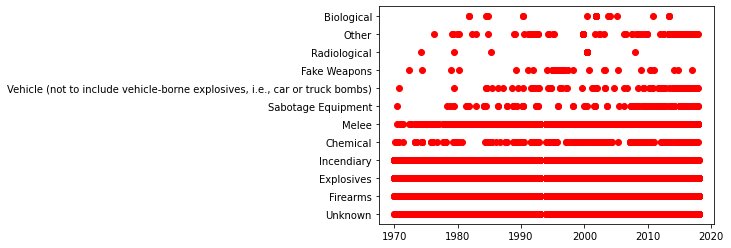

In [29]:
%matplotlib inline 
plt.plot(df['date'], df['weaptype1_txt'], 'ro')

In [57]:
weapon = df[['weaptype1_txt']].value_counts()
weapon

weaptype1_txt                                                              
Explosives                                                                     92099
Firearms                                                                       58347
Unknown                                                                        14890
Incendiary                                                                     11058
Melee                                                                           3624
Chemical                                                                         319
Sabotage Equipment                                                               138
Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)      135
Other                                                                            110
Biological                                                                        33
Fake Weapons                                                              

Text(0, 0.5, 'Number of weapon')

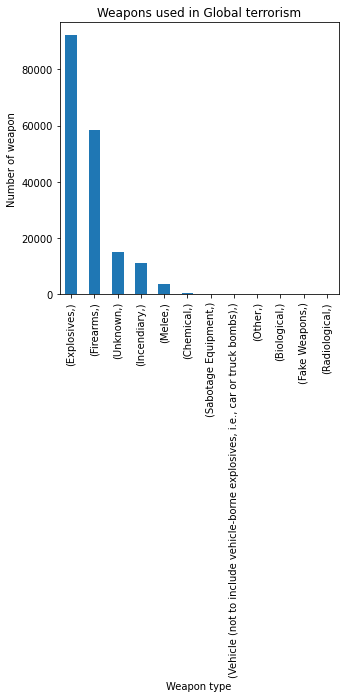

In [59]:
fig = plt.figure(figsize=(5,5)) # define plot area
ax = fig.gca() # define axis    
weapon.plot.bar(ax = ax) # Use the plot.bar method on the counts data frame
ax.set_title('Weapons used in Global terrorism') # Give the plot a main title
ax.set_xlabel('Weapon type') # Set text for the x axis
ax.set_ylabel('Number of weapon')# Set text for y axis

In [65]:
df['nkill']

0         1.0
5         0.0
6         0.0
7         0.0
8         0.0
         ... 
181686    1.0
181687    2.0
181688    0.0
181689    0.0
181690    0.0
Name: nkill, Length: 180800, dtype: float64

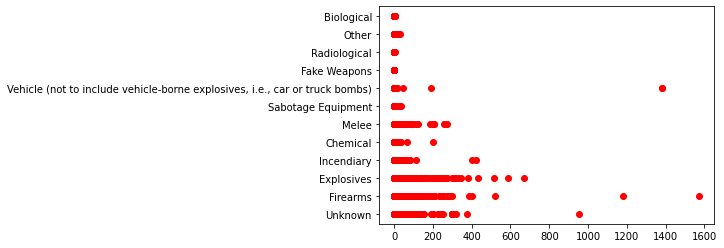

In [64]:
plt.plot(df['nkill'], df['weaptype1_txt'], 'ro')

In [ ]:
x_year = df['date'].unique()
y_year = df['date'].value_counts(dropna=False).sort_index()
plt.figure(figsize=(5,5))
plt.title("Attack in Years")
plt.xlabel("Attack Years")
plt.ylabel("Number of attacks each year")
# plt.xticks(rotation=45)
sns.barplot(x=x_year, y=y_year, palette= 'rocket')
# plt.show()

<AxesSubplot:title={'center':'Attack in Years'}, xlabel='Attack Years', ylabel='date'>